In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from model import TemplateMatcher
from evaluation import evaluate
from data_utils.generator import generate_imgs
from skimage.color import rgb2hsv
from skimage.morphology import erosion, dilation, opening, closing
from scipy.ndimage import median_filter
from skimage.measure import label, regionprops, regionprops_table

In [2]:
df = pd.read_pickle("data/df.pkl")

In [3]:
test_df = generate_imgs(df, 10)

In [4]:
m = TemplateMatcher(["assets/templates/eyes.jpg"])

Templates ['assets/templates/eyes.jpg']
Scales [0.7, 0.8, 0.9, 1, 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2.0]
Angles [-45, -22.5, 0, 22.5, 45]


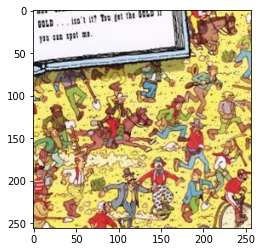

In [5]:
import cv2

ex_img = df[df.name == "19_0_1.jpg"].iloc[0].img
im_g = cv2.cvtColor(ex_img, cv2.COLOR_BGR2GRAY)
im_e = cv2.Canny(im_g, threshold1=10, threshold2=100)
im_hsv = rgb2hsv(ex_img)


#plt.imshow(ex_img)
plt.imshow(ex_img)
plt.show()

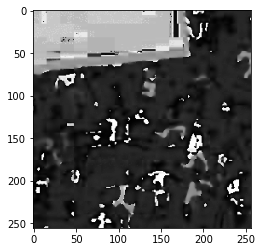

In [6]:
plt.imshow(im_hsv[:, :, 0], cmap="gray")
plt.show()

In [17]:
def waldo_red(img: np.ndarray):
    return (img[:, :, 0] < 0.075) & \
           (img[:, :, 1] > 0.4) & \
           (img[:, :, 2] > 0.2)

def waldo_white(img: np.ndarray):
    return (img[:, :, 1] < 0.1) & \
           (img[:, :, 2] > .8)

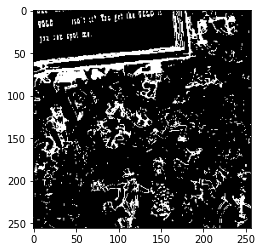

In [46]:
plt.imshow(im_hsv[:, :, 2] < 0.5 , cmap="gray")
plt.show()

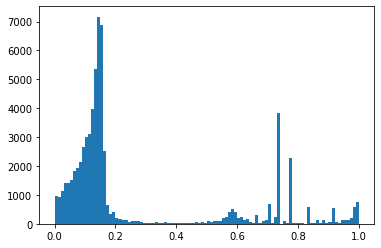

In [18]:
plt.hist(im_hsv[:, :, 0].ravel(), bins=100)
plt.show()

In [19]:
kernel = np.array([
    [0, 0, 1, 0, 0],
    [0, 1, 1, 1, 0],
    [1, 1, 1, 1, 1],
    [0, 1, 1, 1, 0],
    [0, 0, 1, 0, 0],
])
red_blobs = dilation(closing(waldo_red(im_hsv), kernel), kernel)
white_blobs = dilation(closing(waldo_white(im_hsv), kernel), kernel)

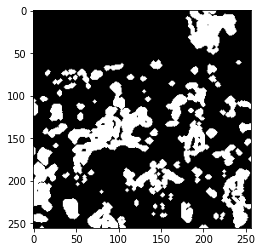

In [20]:
plt.imshow(red_blobs, cmap="gray")
plt.show()

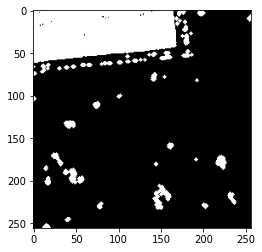

In [21]:
plt.imshow(white_blobs, cmap="gray")
plt.show()

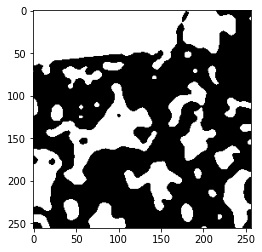

In [22]:
united_blobs = closing(red_blobs | white_blobs, kernel)
united_blobs = median_filter(united_blobs, 10)
plt.imshow(united_blobs, cmap="gray")
plt.show()

     area  bbox-0  bbox-1  bbox-2  bbox-3  centroid-0  centroid-1
0   11835       0       0      76     238   26.638023  104.543388
1       6       8     254      12     256    9.500000  254.666667
2      51      48     178      56     186   51.823529  181.392157
3     204      61      82      71     107   65.357843   93.279412
4     148      65     205      88     218   75.290541  210.804054
5     570      66      34      93      81   76.356140   55.485965
6      21      69     188      74     193   71.000000  190.000000
7       2      71       0      73       1   71.500000    0.000000
8      18      77     140      81     145   78.666667  142.000000
9     901      84     159     137     204  107.578246  179.428413
10   4662      86      15     205     146  145.481767   84.863363
11    330     103     225     126     256  112.981818  237.566667
12     96     104       0     124       6  113.916667    2.062500
13     28     108      72     114      78  110.785714   74.500000
14    220 

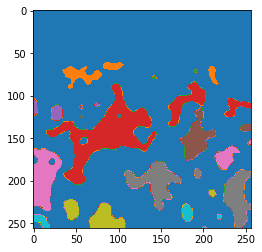

In [23]:

detected = label(united_blobs)
print(pd.DataFrame(regionprops_table(detected, properties=("area", "bbox", "centroid"))))
plt.imshow(detected, cmap="tab10")
plt.show()

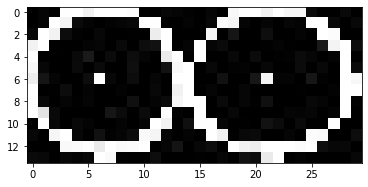

In [51]:
plt.imshow(m.templates[0])
plt.show()

(14, 30, 3)
17_3_1.jpg (93.0, 94.0) (128.5, 71.5)


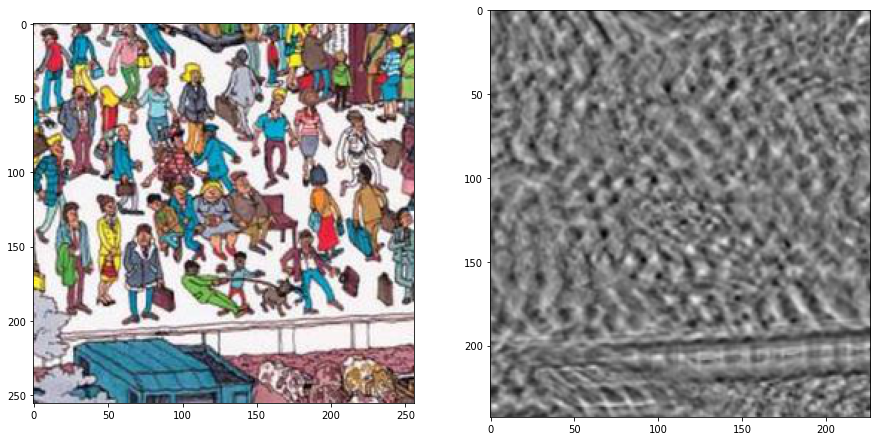

3_3_0.jpg (100.0, 248.0) (70.5, 163.5)


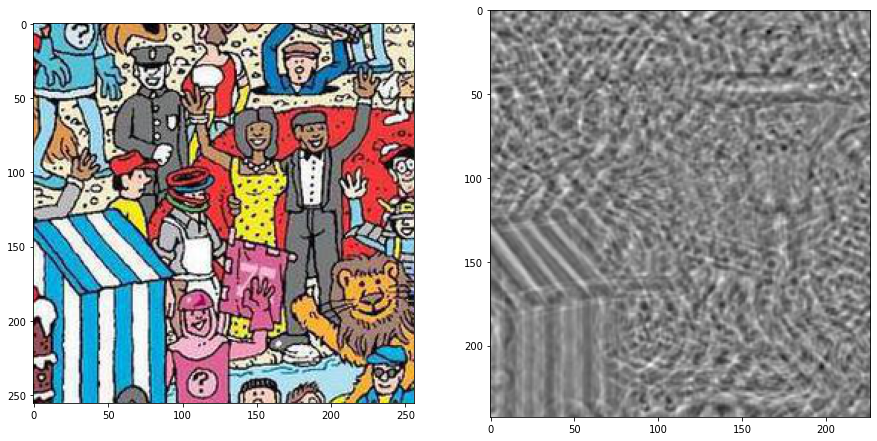

4_0_2.jpg (240.0, 160.0) (38.5, 63.5)


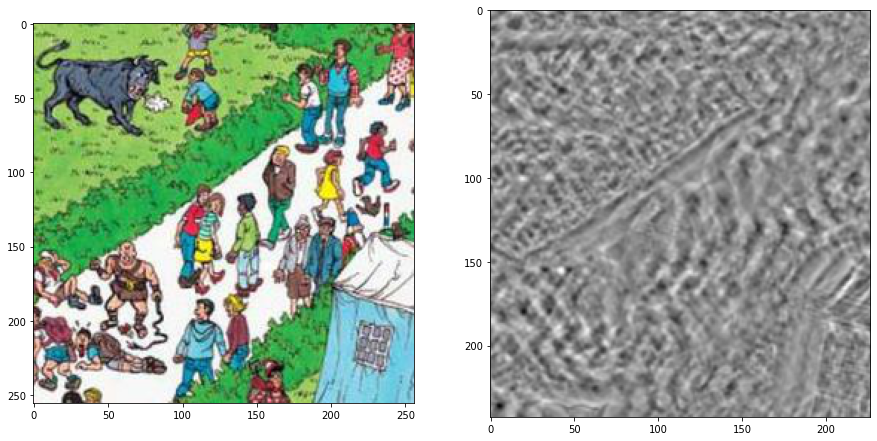

2_1_0.jpg (224.0, 226.0) (72.5, 100.5)


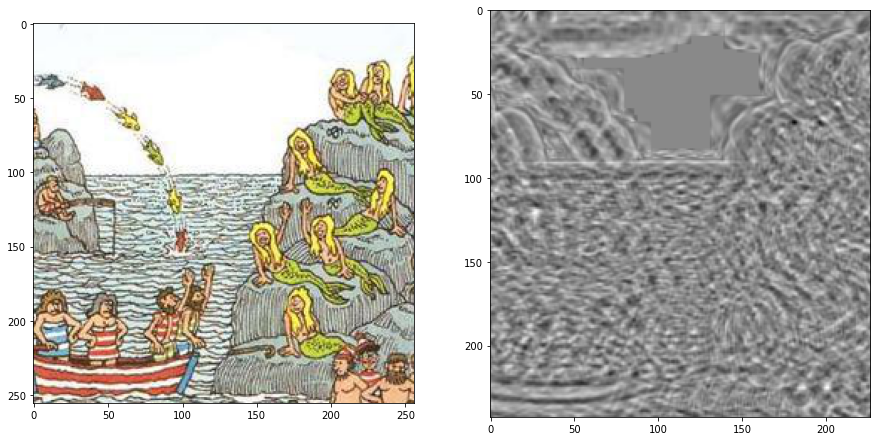

5_1_0.jpg (224.0, 226.0) (72.5, 100.5)


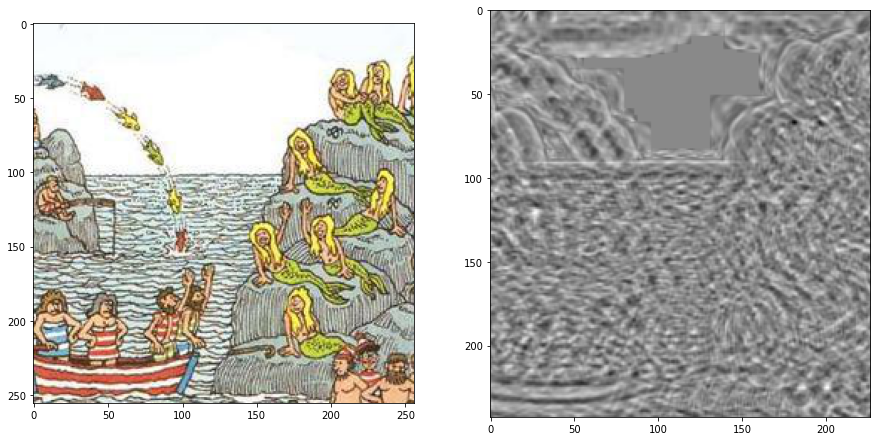

13_0_2.jpg (240.0, 184.0) (96.0, 190.5)


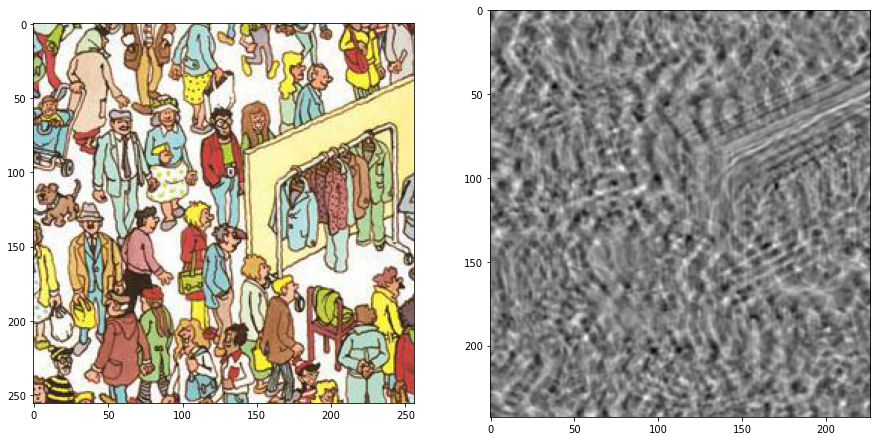

16_2_0.jpg (245.0, 180.0) (124.0, 243.5)


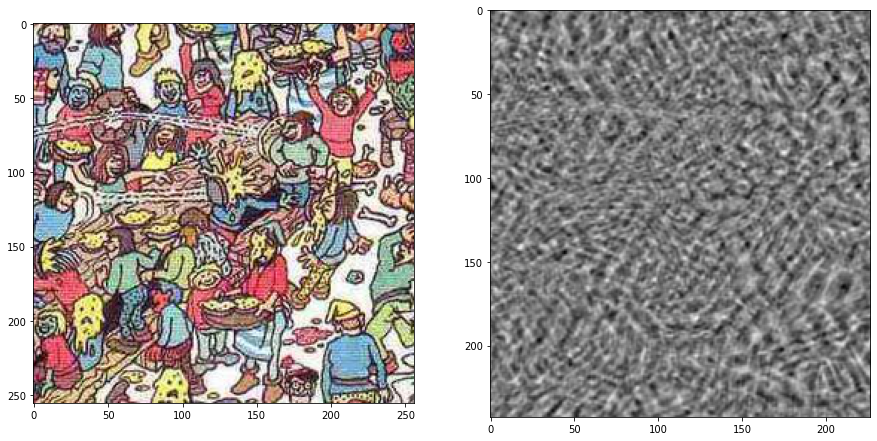

1_1_1.jpg (190.0, 11.0) (208.5, 50.5)


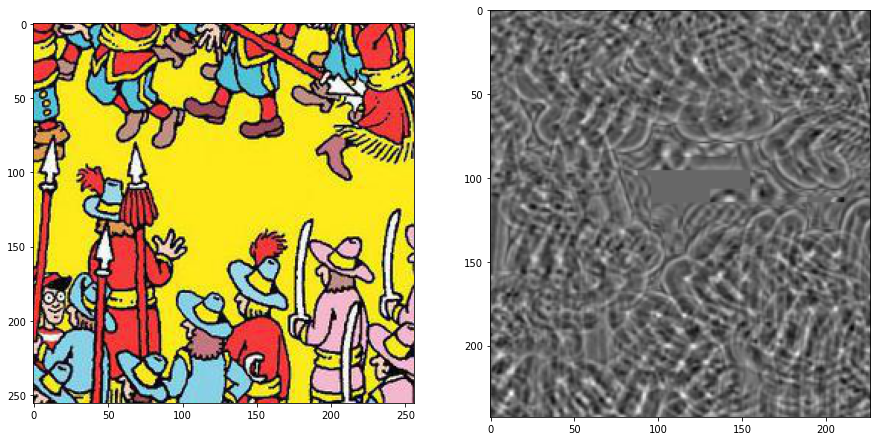

19_2_3.jpg (61.0, 122.0) (75.5, 220.5)


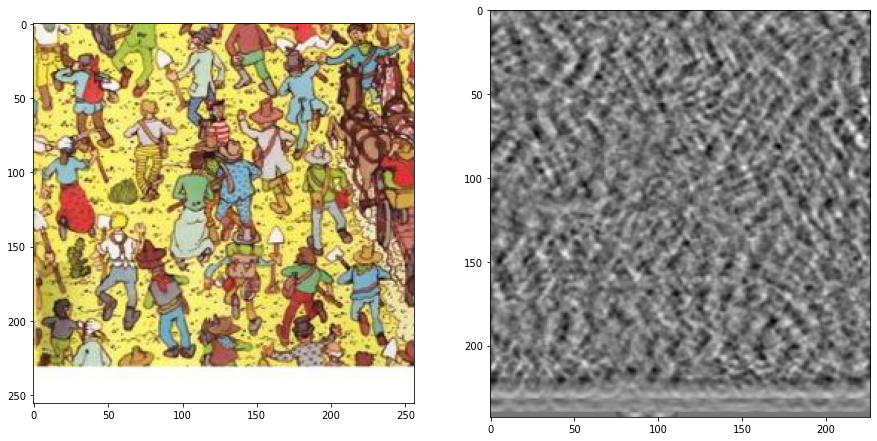

9_0_2.jpg (135.0, 13.0) (139.0, 164.0)


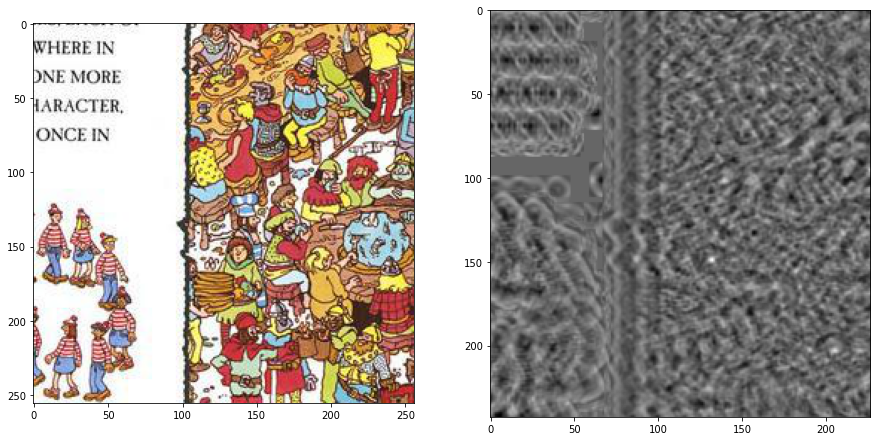

5_0_1.jpg (88.0, 146.0) (216.5, 173.5)


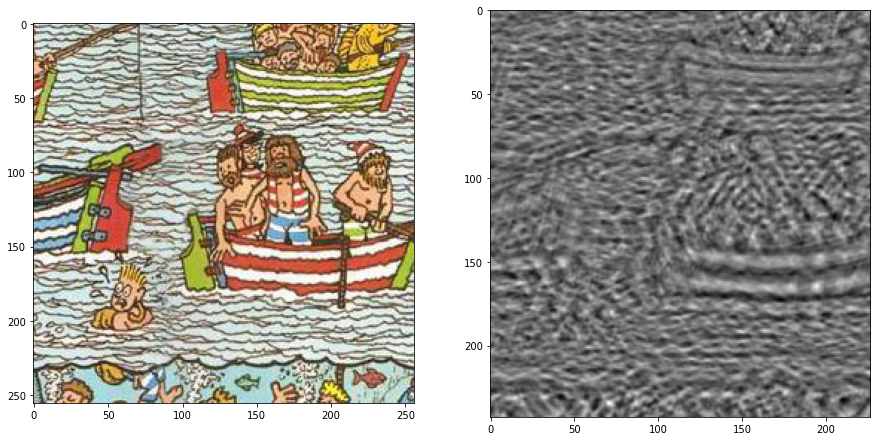

6_3_0.jpg (100.0, 250.0) (70.5, 163.5)


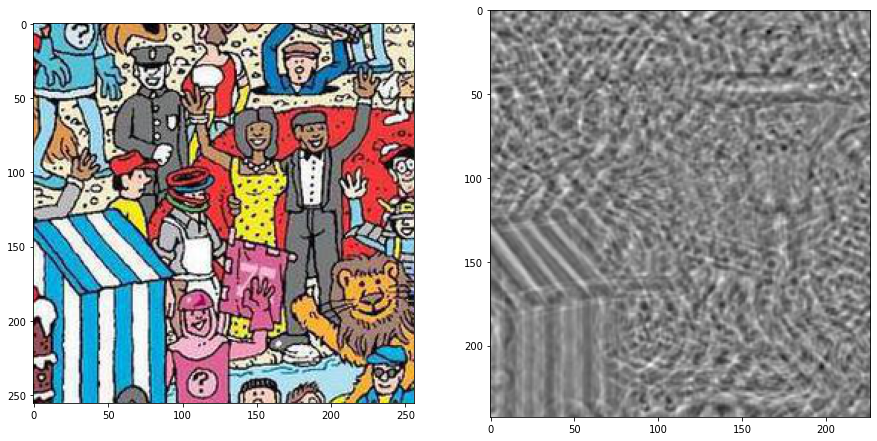

12_0_0.jpg (125.0, 152.0) (147.0, 129.5)


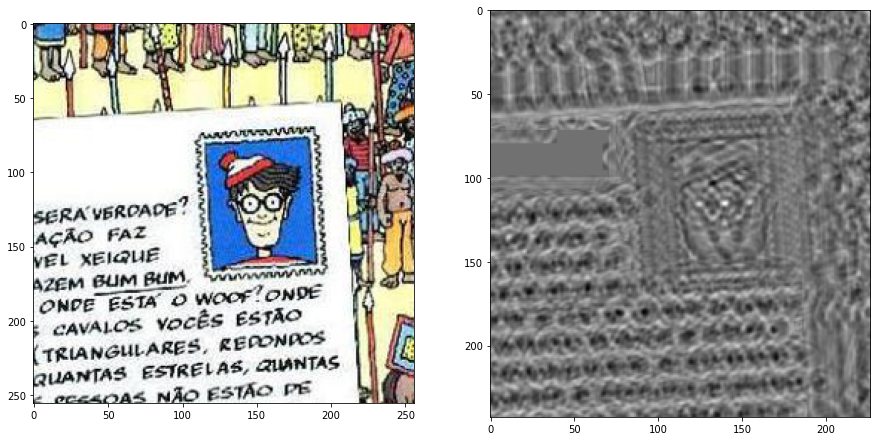

14_0_3.jpg (44.0, 81.0) (28.5, 165.5)


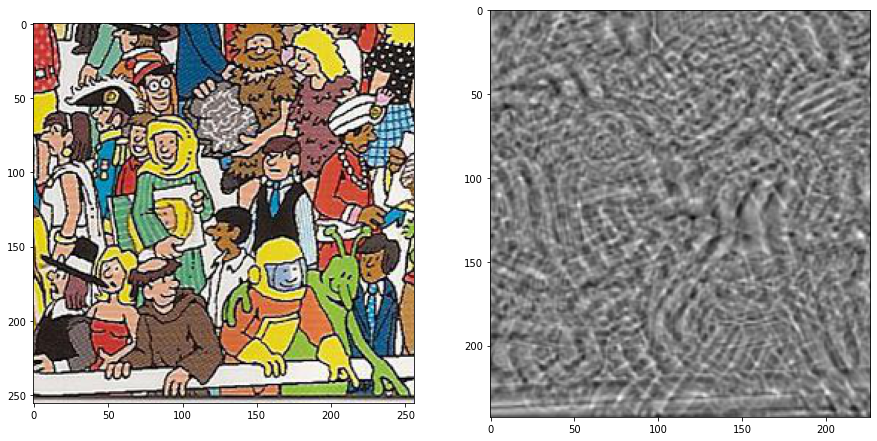

13_1_0.jpg (187.0, 127.0) (158.5, 185.0)


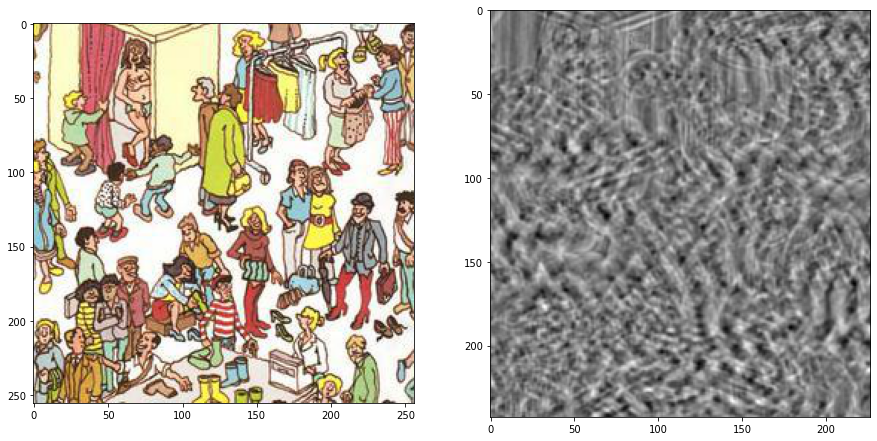

18_3_1.jpg (190.0, 190.0) (135.0, 226.5)


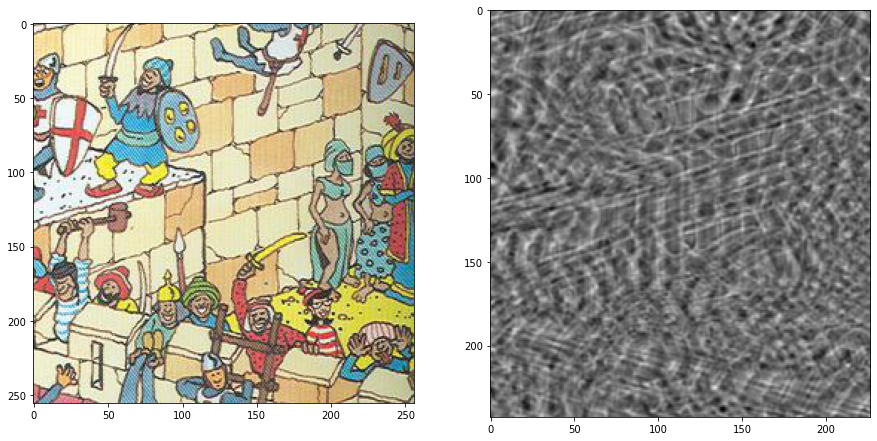

18_0_3.jpg (190.0, 133.0) (50.5, 198.5)


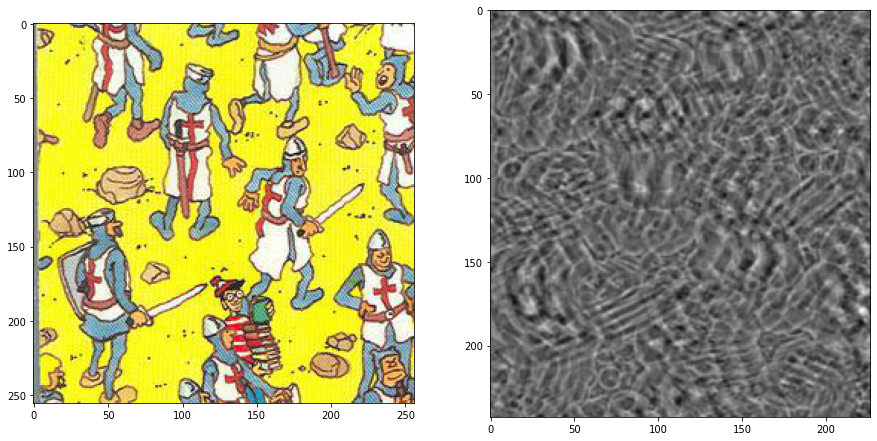

21_0_0.jpg (87.0, 53.0) (63.5, 93.0)


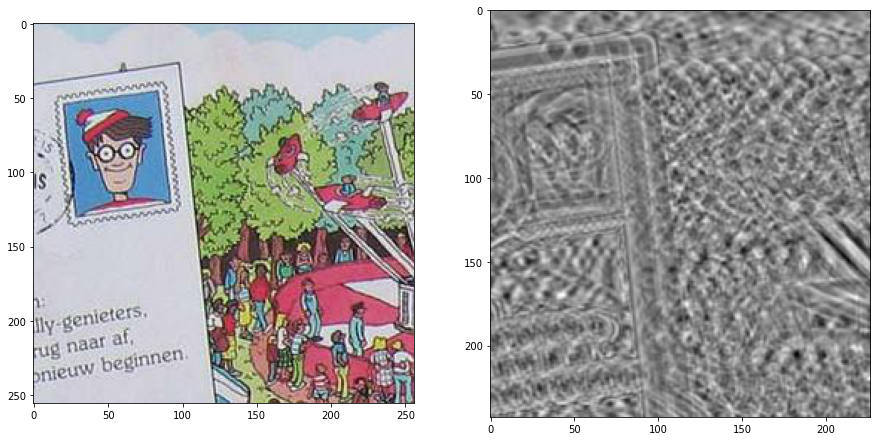

10_3_1.jpg (51.0, 245.0) (10.5, 126.0)


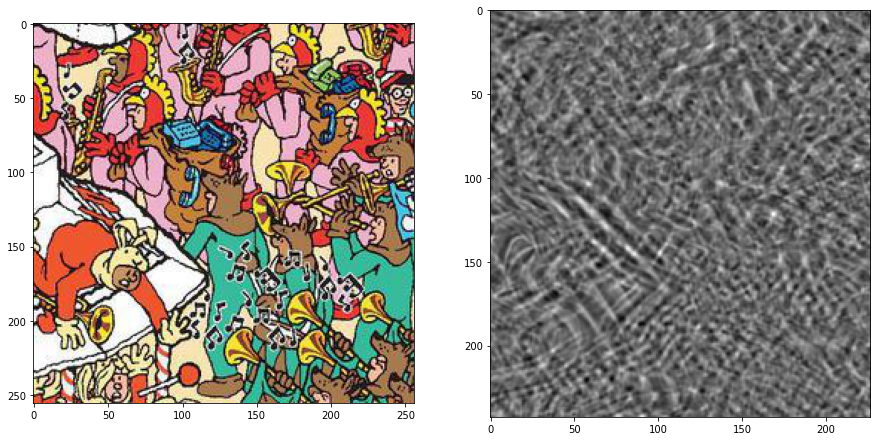

11_1_2.jpg (197.0, 156.0) (137.5, 174.5)


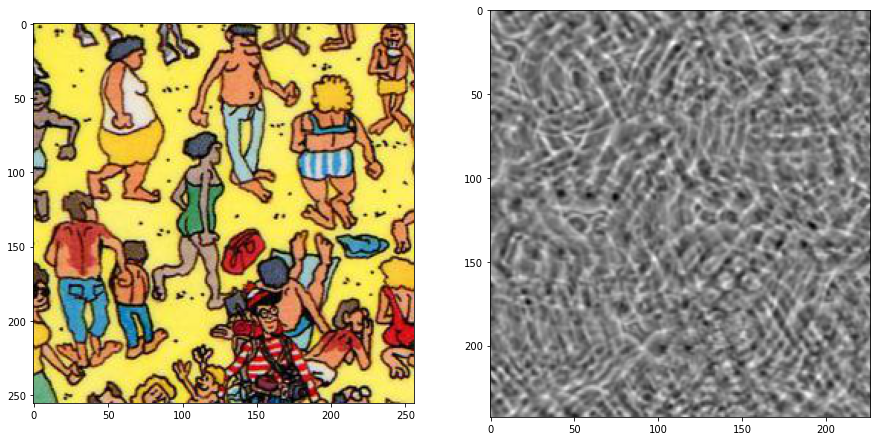

9_0_3.jpg (40.0, 61.0) (209.5, 135.5)


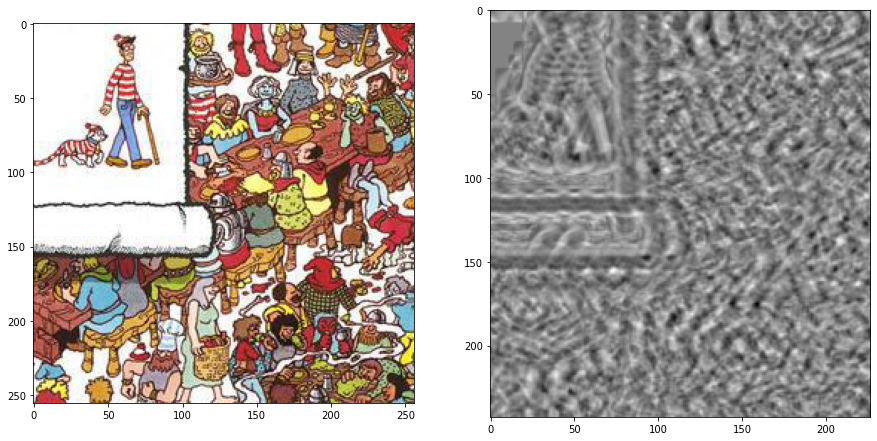

13_0_3.jpg (6.0, 180.0) (95.5, 219.5)


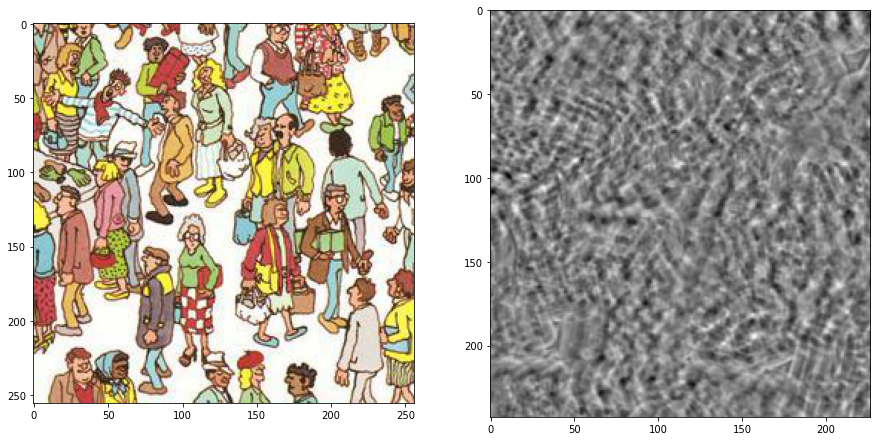

19_0_1.jpg (196.0, 7.0) (86.5, 62.5)


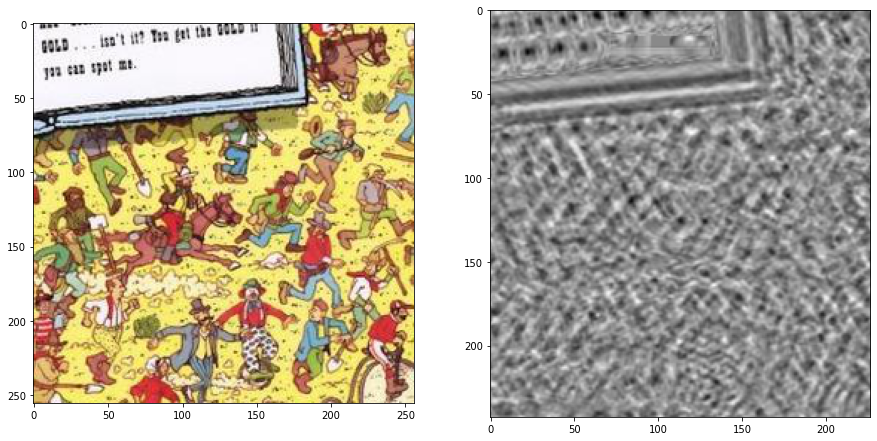

7_3_1.jpg (114.0, 35.0) (44.5, 178.5)


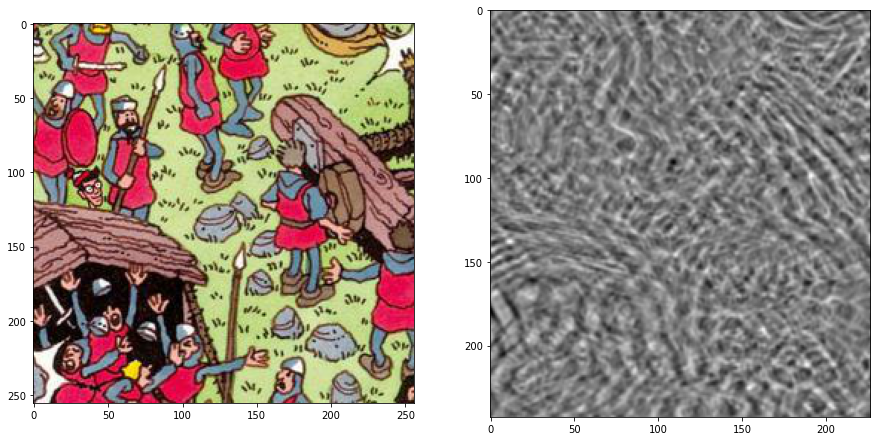

11_3_3.jpg (20.0, 190.0) (191.5, 70.5)


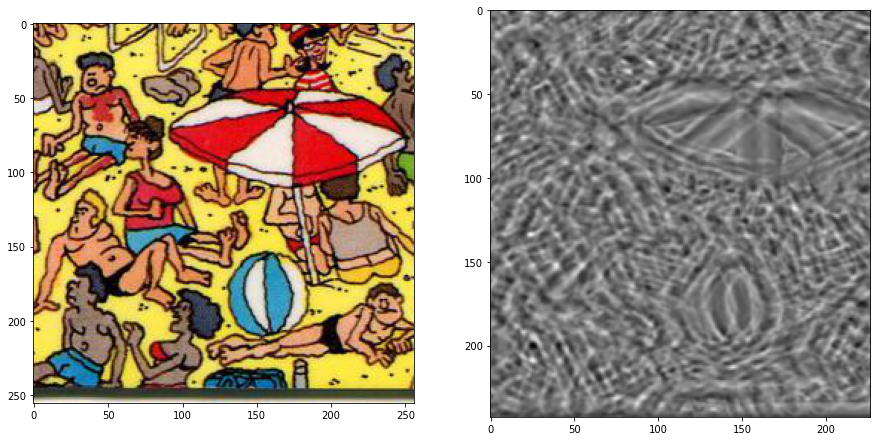

2_0_1.jpg (87.0, 147.0) (216.5, 173.5)


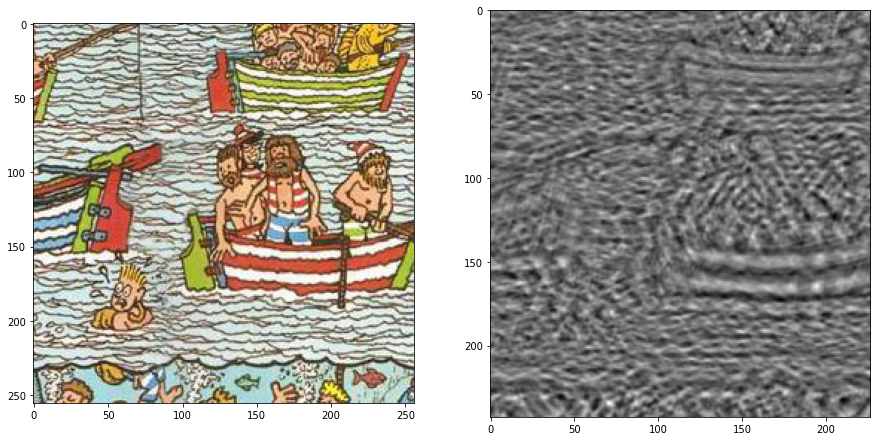

4_0_3.jpg (5.0, 160.0) (172.5, 89.5)


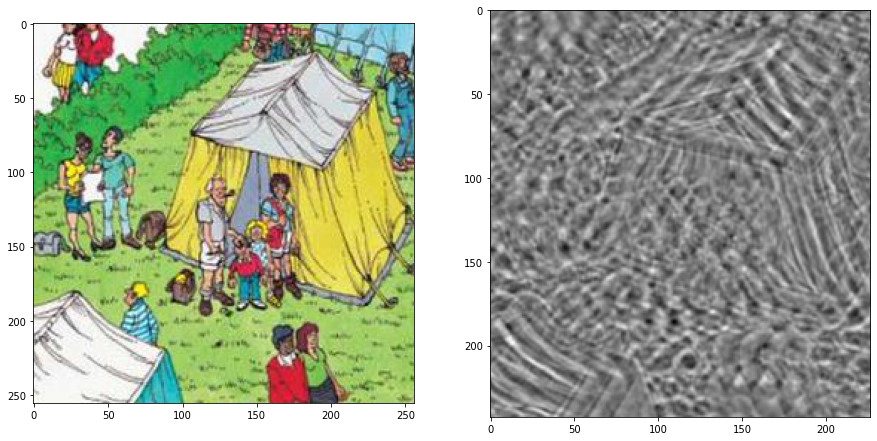

9_1_1.jpg (82.0, 75.0) (132.5, 87.5)


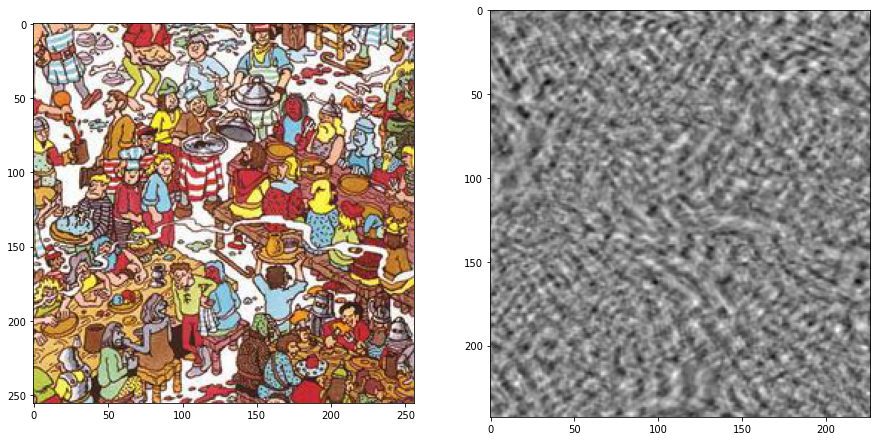

13_0_0.jpg (108.0, 83.0) (78.5, 113.0)


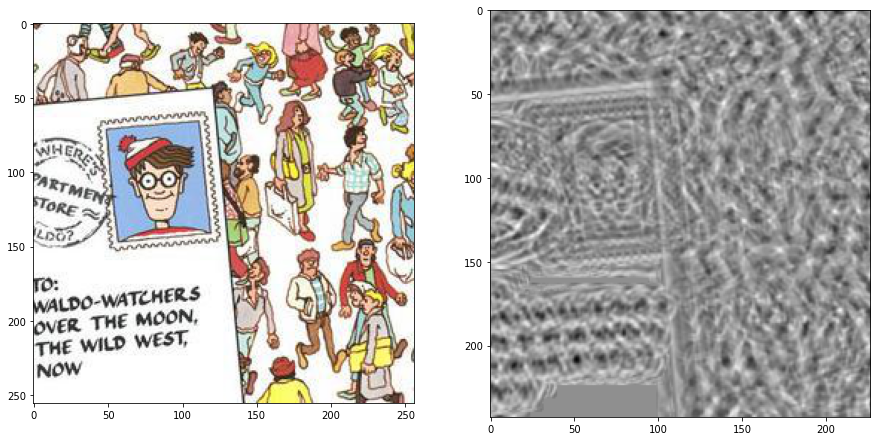

16_2_1.jpg (25.0, 175.0) (164.5, 84.5)


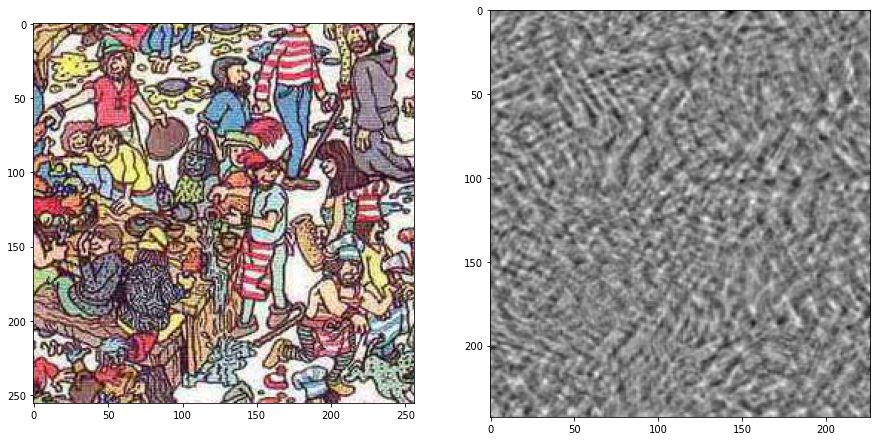

12_0_3.jpg (16.0, 224.0) (217.5, 110.5)


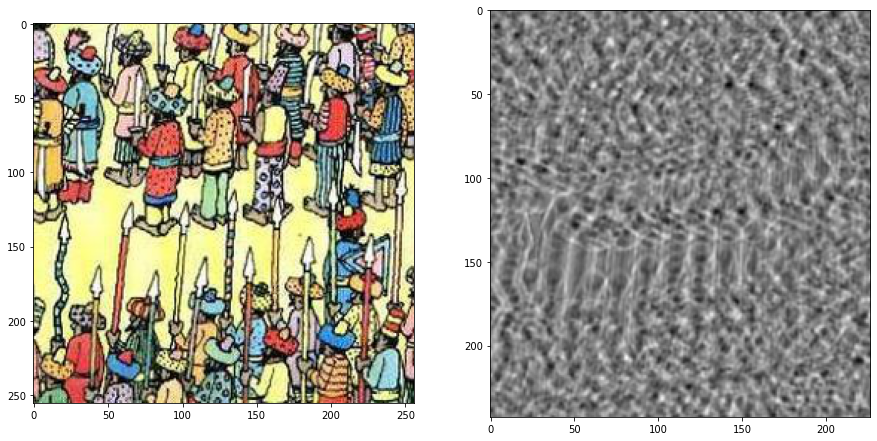

In [41]:
print(m.templates[0].shape)
for name, img, pos in zip(df[df.waldo].name, df[df.waldo].img, df[df.waldo].pos):
    fix, axes = plt.subplots(1, 2, figsize=(15, 15))
    axes[0].imshow(img)
    axes[1].imshow(m.match(img, m.templates[0]), cmap="gray")
    print(name, pos, m.predict(img))
    plt.show()

In [7]:
_ = evaluate(test_df, m)

Best size 0.7 w/ score 0.3154
Best size 0.8 w/ score 0.3427
Best template assets/templates/torso.jpg w/ score 0.3427
Best size 0.7 w/ score 0.3335
Best size 0.7 w/ score 0.3644
Best template assets/templates/torso.jpg w/ score 0.3644
Best size 0.8 w/ score 0.3015
Best size 0.7 w/ score 0.3751
Best template assets/templates/torso.jpg w/ score 0.3751
Best size 0.7 w/ score 0.2789
Best size 0.8 w/ score 0.2948
Best template assets/templates/torso.jpg w/ score 0.2948
Best size 0.7 w/ score 0.3076
Best size 0.7 w/ score 0.3668
Best template assets/templates/torso.jpg w/ score 0.3668
Best size 0.7 w/ score 0.2884
Best size 0.7 w/ score 0.383
Best template assets/templates/torso.jpg w/ score 0.383
Best size 0.7 w/ score 0.3114
Best size 0.7 w/ score 0.3589
Best template assets/templates/torso.jpg w/ score 0.3589
Best size 0.7 w/ score 0.3043
Best size 0.8 w/ score 0.3481
Best template assets/templates/torso.jpg w/ score 0.3481
Best size 0.7 w/ score 0.3236
Best size 0.7 w/ score 0.3605
Best t

(44.0, 81.0)


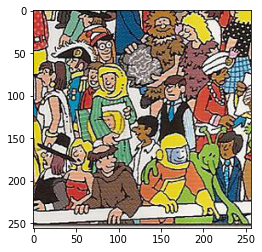

In [7]:
ex = df[df.name == "14_0_3.jpg"].iloc[0]
img = ex.img
print(ex.pos)
cands = m.candidates(img)
plt.imshow(img)
plt.show()

In [8]:
cands.sort_values(by="score",ascending=False)[:30]

,pos,score,template,transform
2,"(24.5, 110.5)",0.435221,assets/templates/eyes.jpg,"scale=0.7,angle=0"
7,"(221.5, 238.0)",0.392967,assets/templates/eyes.jpg,"scale=0.8,angle=0"
12,"(136.0, 243.5)",0.377424,assets/templates/eyes.jpg,"scale=0.9,angle=0"
22,"(196.5, 29.5)",0.348430,assets/templates/eyes.jpg,"scale=1.1,angle=0"
3,"(188.5, 243.5)",0.315433,assets/templates/eyes.jpg,"scale=0.7,angle=22.5"
17,"(190.0, 205.0)",0.314985,assets/templates/eyes.jpg,"scale=1,angle=0"
5,"(37.5, 22.0)",0.307952,assets/templates/eyes.jpg,"scale=0.8,angle=-45"
37,"(179.5, 234.0)",0.301676,assets/templates/eyes.jpg,"scale=1.4000000000000001,angle=0"
32,"(62.0, 153.5)",0.299697,assets/templates/eyes.jpg,"scale=1.3,angle=0"
1,"(233.5, 152.5)",0.282756,assets/templates/eyes.jpg,"scale=0.7,angle=-22.5"
